In [1]:
import seaborn as sns
import os
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import missingno as msno
from sklearn.model_selection import train_test_split
import sklearn.metrics as mt # 성능지표를 계산하기 위해 import
from sklearn.metrics import accuracy_score
import warnings
warnings.filterwarnings('ignore')
seed = 5764

# Data 불러오기

In [2]:
Knnframes = []
for i in range(1,6):
    temp =  pd.read_csv("Kdf_"+str(i)+"year.csv")
    Knnframes.append(temp)
Miceframes = []
for i in range(1,6):
    temp =  pd.read_csv("Mdf_"+str(i)+"year.csv")
    Miceframes.append(temp)
Simpleframes = []
for i in range(1,6):
    temp =  pd.read_csv("Sdf_"+str(i)+"year.csv")
    Simpleframes.append(temp)

# OverSampling

In [3]:
# SMOTE 패키지로 oversampling 진행
from imblearn.over_sampling import SMOTE

MXs=[]
MYs=[]

print("----MICE 데이터셋 1~5 오버샘플링----")
for i in range(5):
    X = Miceframes[i].drop(labels=['bankruptcy'], axis=1)
    y = Miceframes[i]['bankruptcy']
    oversample = SMOTE()
    resampled_X, resampled_Y = oversample.fit_resample(X,y)
    
    MXs.append(resampled_X)
    MYs.append(resampled_Y)
    
    # 불균형 처리 결과
    print(str(i+1)+"번째 Data set 오버샘플링 결과")
    print(resampled_Y.value_counts())
    print()


KXs=[]
KYs=[]

print("\n----KNN 데이터셋 1~5 오버샘플링----")
for i in range(5):
    X = Knnframes[i].drop(labels=['bankruptcy'], axis=1)
    y = Knnframes[i]['bankruptcy']
    oversample = SMOTE()
    resampled_X, resampled_Y = oversample.fit_resample(X,y)
    
    KXs.append(resampled_X)
    KYs.append(resampled_Y)
    
    # 불균형 처리 결과
    print(str(i+1)+"번째 Data set 오버샘플링 결과")
    print(resampled_Y.value_counts())
    print()


SXs=[]
SYs=[]

print("\n----Simple 데이터셋 1~5 오버샘플링----")
for i in range(5):
    X =Simpleframes[i].drop(labels=['bankruptcy'], axis=1)
    y = Simpleframes[i]['bankruptcy']
    oversample = SMOTE()
    resampled_X, resampled_Y = oversample.fit_resample(X,y)
    
    SXs.append(resampled_X)
    SYs.append(resampled_Y)
    
    # 불균형 처리 결과
    print(str(i+1)+"번째 Data set 오버샘플링 결과")
    print(resampled_Y.value_counts())
    print()

----MICE 데이터셋 1~5 오버샘플링----
1번째 Data set 오버샘플링 결과
-5    6672
 5    6672
Name: bankruptcy, dtype: int64

2번째 Data set 오버샘플링 결과
-4    9683
 4    9683
Name: bankruptcy, dtype: int64

3번째 Data set 오버샘플링 결과
-3    9921
 3    9921
Name: bankruptcy, dtype: int64

4번째 Data set 오버샘플링 결과
-2    9195
 2    9195
Name: bankruptcy, dtype: int64

5번째 Data set 오버샘플링 결과
-1    5440
 1    5440
Name: bankruptcy, dtype: int64


----KNN 데이터셋 1~5 오버샘플링----
1번째 Data set 오버샘플링 결과
-5    6672
 5    6672
Name: bankruptcy, dtype: int64

2번째 Data set 오버샘플링 결과
-4    9683
 4    9683
Name: bankruptcy, dtype: int64

3번째 Data set 오버샘플링 결과
-3    9921
 3    9921
Name: bankruptcy, dtype: int64

4번째 Data set 오버샘플링 결과
-2    9195
 2    9195
Name: bankruptcy, dtype: int64

5번째 Data set 오버샘플링 결과
-1    5440
 1    5440
Name: bankruptcy, dtype: int64


----Simple 데이터셋 1~5 오버샘플링----
1번째 Data set 오버샘플링 결과
-5    6372
 5    6372
Name: bankruptcy, dtype: int64

2번째 Data set 오버샘플링 결과
-4    8947
 4    8947
Name: bankruptcy, dtype: int64

3

In [4]:
for i in range(5):
    MYs[i] = MYs[i].astype(int)
for i in range(5):
    KYs[i] = KYs[i].astype(int)
for i in range(5):
    SYs[i] = SYs[i].astype(int)

In [26]:
def matrix_show(model,xtest,xtrain,ytest,ytrain,pred):
    # 학습결과 평가
    print("Train_Accuracy : ", model.score(xtrain,ytrain), '\n')
    print("Test_Accuracy : ", model.score(xtest,ytest), '\n')

    # 다중 클래스 분류일 경우 average='micro' 를 하이퍼파라미터로 넣어줌(accuracy, matrix 제외)
    accuracy = mt.accuracy_score(ytest, pred)
    recall = mt.recall_score(ytest, pred,average='micro')
    precision = mt.precision_score(ytest,pred,average='micro')
    f1_score = mt.f1_score(ytest, pred,average='micro')
    matrix = mt.confusion_matrix(ytest, pred)

    print('Accuracy: ', format(accuracy,'.2f'),'\n')
    print('Recall: ', format(recall,'.2f'),'\n')
    print('Precision: ', format(precision,'.2f'),'\n')
    print('F1_score: ', format(f1_score,'.2f'),'\n')
    print('Confusion Matrix:','\n', matrix)

# 중요 변수 파악

In [5]:
import os
os.environ["PATH"]+= os.pathsep+"C:/Program Files/Graphviz/bin/"
import graphviz # tree 시각화

In [6]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.tree import export_graphviz # tree 시각화를 위해
import sklearn.metrics as mt # 성능지표를 계산하기 위해 import
from sklearn.model_selection import cross_val_score, cross_validate # 교차검증
from sklearn.model_selection import train_test_split # 학습, 테스트set 구분

In [7]:
!pip install graphviz

You should consider upgrading via the 'd:\program files\python\python3.9\python.exe -m pip install --upgrade pip' command.


In [8]:
Mx_train= [0 for i in range(5)]
Mx_test= [0 for i in range(5)]
My_train= [0 for i in range(5)]
My_test =[0 for i in range(5)]
for i in range(5):
    Mx_train[i], Mx_test[i], My_train[i], My_test[i] = train_test_split(MXs[i],MYs[i],test_size=0.3,random_state=seed)

# 5년후 파산(5)과 파산하지 않음(-5)을 분류하는 Decision Tree

In [13]:
dt_clf = DecisionTreeClassifier(random_state=404,min_impurity_decrease=0.005)
dt_clf.fit(Mx_train[0],My_train[0]) # 학습
classe_names = dt_clf.classes_
classe_names= classe_names.astype(str)

In [14]:
My_pred = dt_clf.predict(Mx_test[0]) 

In [15]:
import sklearn.metrics as mt # 성능지표를 계산하기 위해 import
# 학습결과 평가
#print("Train_Accuracy : ", model.score(MX_train, My_train), '\n')
#print("Test_Accuracy : ", model.score(MX_test, My_test), '\n')

# 다중 클래스 분류일 경우 average='micro' 를 하이퍼파라미터로 넣어줌(accuracy, matrix 제외)
accuracy = mt.accuracy_score(My_test[0], My_pred)
recall = mt.recall_score(My_test[0], My_pred,average='micro')
precision = mt.precision_score(My_test[0], My_pred,average='micro')
f1_score = mt.f1_score(My_test[0], My_pred,average='micro')
matrix = mt.confusion_matrix(My_test[0], My_pred)

print('Accuracy: ', format(accuracy,'.2f'),'\n')
print('Recall: ', format(recall,'.2f'),'\n')
print('Precision: ', format(precision,'.2f'),'\n')
print('F1_score: ', format(f1_score,'.2f'),'\n')
print('Confusion Matrix:','\n', matrix)

Accuracy:  0.86 

Recall:  0.86 

Precision:  0.86 

F1_score:  0.86 

Confusion Matrix: 
 [[1787  268]
 [ 302 1647]]


In [16]:
# export_graphviz( )의 호출 결과로 out_file로 지정된 tree.dot 파일을 생성
export_graphviz(dt_clf, out_file="tree.dot", class_names =classe_names, feature_names =MXs[0].columns, impurity=True, filled=True)

In [17]:
# 생성된 .dot 파일을 .png로 변환
from subprocess import call
call(['dot', '-Tpng', 'tree.dot', '-o', 'MICE_decistion-tree_AF5year.png', '-Gdpi=600'])

0

In [18]:
# jupyter notebook에서 .png 직접 출력
from IPython.display import Image
Image(filename = 'MICE_decistion-tree_AF5year.png')

[ max_depth의 제약이 없는 경우의 Decision Tree 시각화 ]


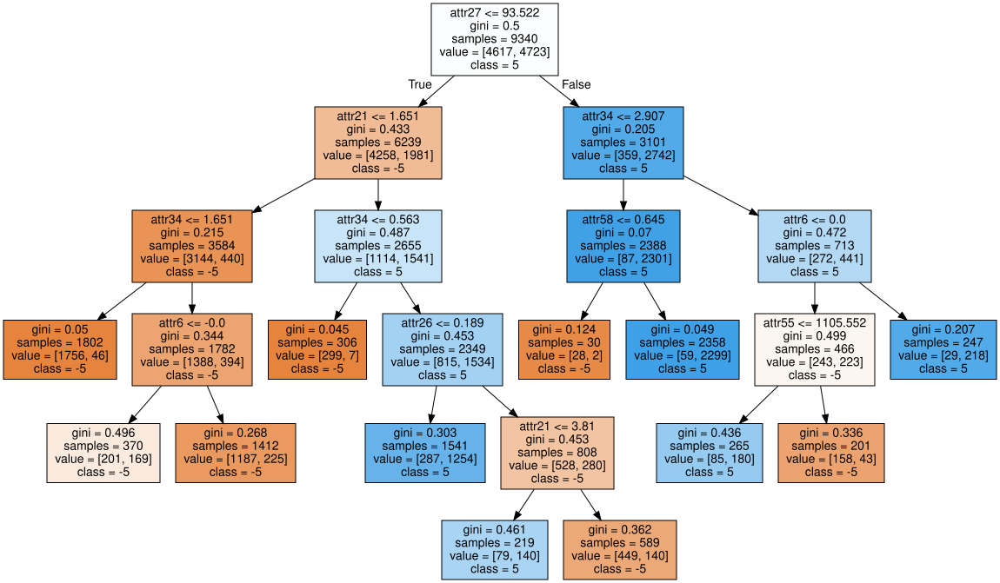

In [19]:
print('[ max_depth의 제약이 없는 경우의 Decision Tree 시각화 ]')
# 위에서 생성된 tree.dot 파일을 Graphiviz 가 읽어서 시각화
with open("tree.dot") as f:
    dot_graph = f.read()
graphviz.Source(dot_graph)

# 4년후 파산(4)과 파산하지 않음(-4)을 분류하는 Decision Tree

In [20]:
dt_clf = DecisionTreeClassifier(random_state=404,min_impurity_decrease=0.005)
dt_clf.fit(Mx_train[1],My_train[1]) # 학습
classe_names = dt_clf.classes_
classe_names =classe_names.astype(str)
My_pred = dt_clf.predict(Mx_test[1]) 

In [21]:
import sklearn.metrics as mt # 성능지표를 계산하기 위해 import
# 학습결과 평가
#print("Train_Accuracy : ", model.score(MX_train, My_train), '\n')
#print("Test_Accuracy : ", model.score(MX_test, My_test), '\n')

# 다중 클래스 분류일 경우 average='micro' 를 하이퍼파라미터로 넣어줌(accuracy, matrix 제외)
accuracy = mt.accuracy_score(My_test[1], My_pred)
recall = mt.recall_score(My_test[1], My_pred,average='micro')
precision = mt.precision_score(My_test[1], My_pred,average='micro')
f1_score = mt.f1_score(My_test[1], My_pred,average='micro')
matrix = mt.confusion_matrix(My_test[1], My_pred)

print('Accuracy: ', format(accuracy,'.2f'),'\n')
print('Recall: ', format(recall,'.2f'),'\n')
print('Precision: ', format(precision,'.2f'),'\n')
print('F1_score: ', format(f1_score,'.2f'),'\n')
print('Confusion Matrix:','\n', matrix)

Accuracy:  0.82 

Recall:  0.82 

Precision:  0.82 

F1_score:  0.82 

Confusion Matrix: 
 [[2315  628]
 [ 432 2435]]


In [22]:
# export_graphviz( )의 호출 결과로 out_file로 지정된 tree.dot 파일을 생성
export_graphviz(dt_clf, out_file="tree.dot", class_names =classe_names, feature_names =MXs[0].columns, impurity=True, filled=True)

In [23]:
# 생성된 .dot 파일을 .png로 변환
from subprocess import call
call(['dot', '-Tpng', 'tree.dot', '-o', 'MICE_decistion-tree_AF4year.png', '-Gdpi=600'])

0

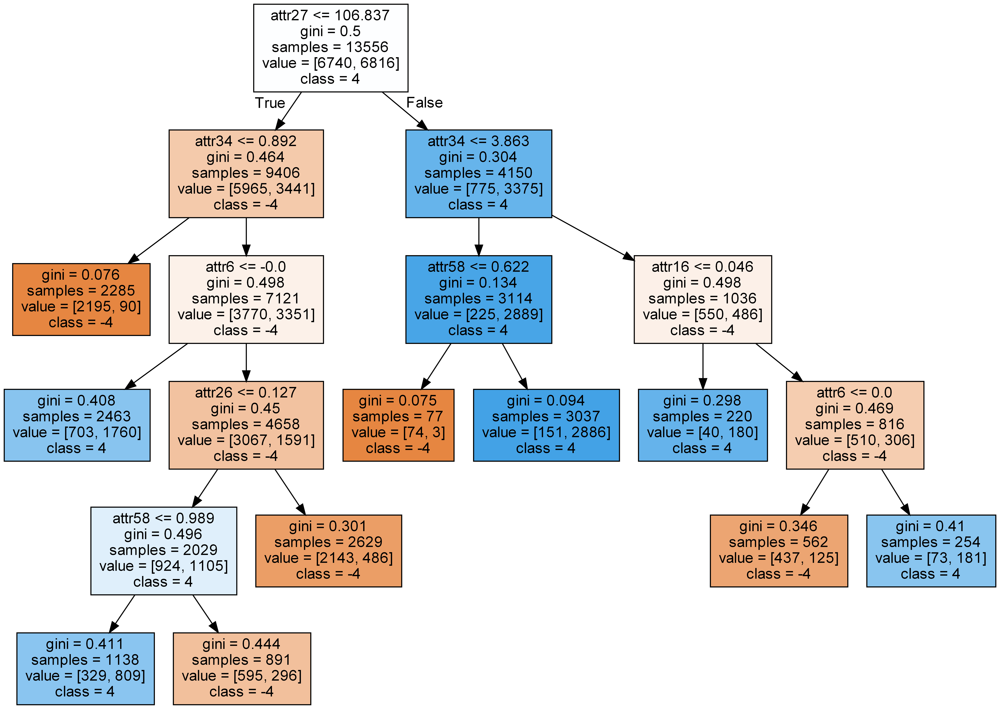

In [24]:
# jupyter notebook에서 .png 직접 출력
from IPython.display import Image
Image(filename = 'MICE_decistion-tree_AF4year.png')

[ max_depth의 제약이 없는 경우의 Decision Tree 시각화 ]


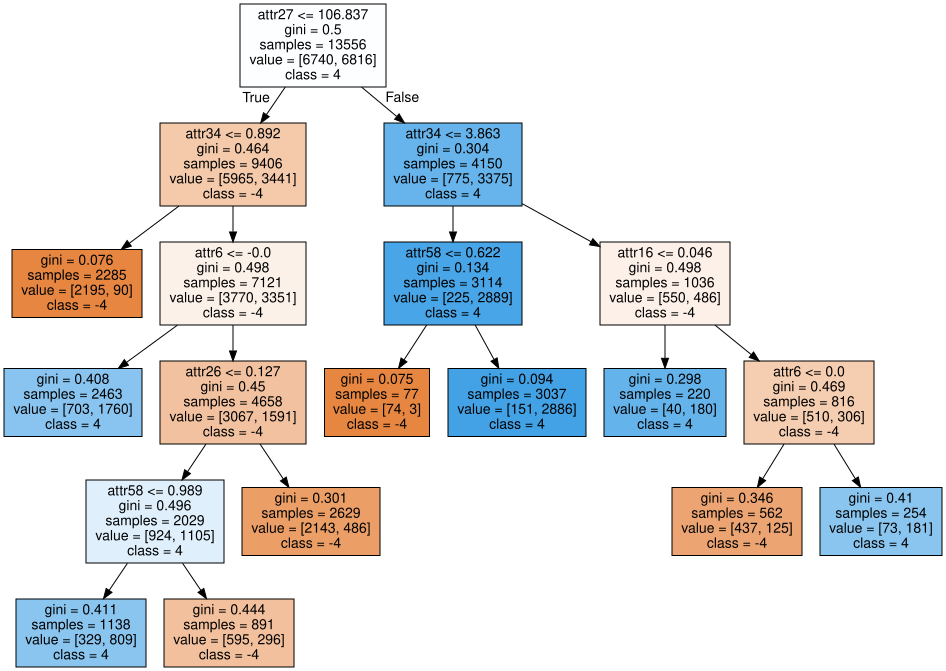

In [25]:
print('[ max_depth의 제약이 없는 경우의 Decision Tree 시각화 ]')
# 위에서 생성된 tree.dot 파일을 Graphiviz 가 읽어서 시각화
with open("tree.dot") as f:
    dot_graph = f.read()
graphviz.Source(dot_graph)

# 3년후 파산(3)과 파산하지 않음(-3)을 분류하는 Decision Tree

In [27]:
dt_clf = DecisionTreeClassifier(random_state=404,min_impurity_decrease=0.005)
dt_clf.fit(Mx_train[2],My_train[2]) # 학습
classe_names = dt_clf.classes_
classe_names= classe_names.astype(str)

In [28]:
My_pred = dt_clf.predict(Mx_test[2])

In [29]:
matrix_show(dt_clf,Mx_test[2],Mx_train[2],My_test[2],My_train[2],My_pred)

Train_Accuracy :  0.8254733962128303 

Test_Accuracy :  0.820258693095918 

Accuracy:  0.82 

Recall:  0.82 

Precision:  0.82 

F1_score:  0.82 

Confusion Matrix: 
 [[2512  522]
 [ 548 2371]]


In [30]:
# export_graphviz( )의 호출 결과로 out_file로 지정된 tree.dot 파일을 생성
export_graphviz(dt_clf, out_file="tree.dot", class_names =classe_names, feature_names =MXs[1].columns, impurity=True, filled=True)

In [31]:
# 생성된 .dot 파일을 .png로 변환
from subprocess import call
call(['dot', '-Tpng', 'tree.dot', '-o', 'MICE_decistion-tree_AF3year.png', '-Gdpi=600'])

0

In [32]:
# jupyter notebook에서 .png 직접 출력
from IPython.display import Image
Image(filename = 'MICE_decistion-tree_AF3year.png')

[ max_depth의 제약이 없는 경우의 Decision Tree 시각화 ]


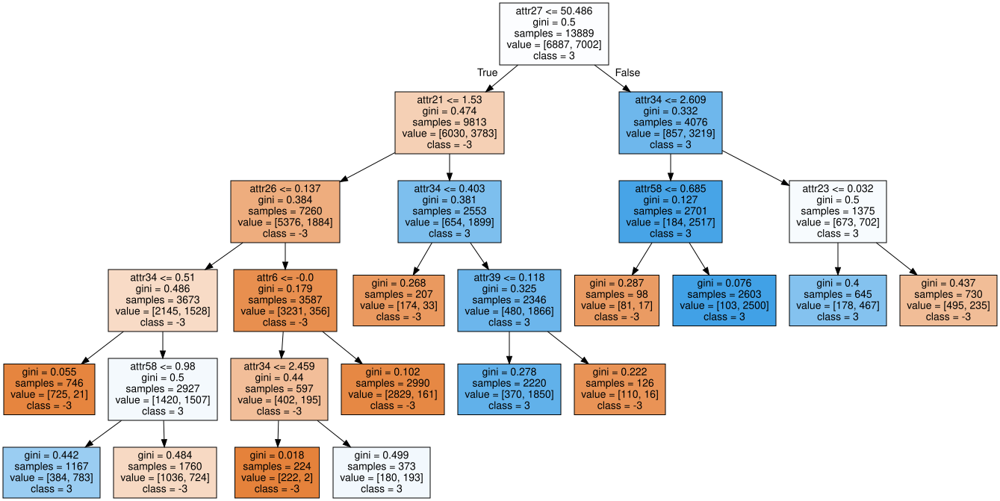

In [33]:
print('[ max_depth의 제약이 없는 경우의 Decision Tree 시각화 ]')
# 위에서 생성된 tree.dot 파일을 Graphiviz 가 읽어서 시각화
with open("tree.dot") as f:
    dot_graph = f.read()
graphviz.Source(dot_graph)

# 2년후 파산(2)과 파산하지 않음(-2)을 분류하는 Decision Tree

In [34]:
dt_clf = DecisionTreeClassifier(random_state=404,min_impurity_decrease=0.005)
dt_clf.fit(Mx_train[3],My_train[3]) # 학습
classe_names = dt_clf.classes_
classe_names= classe_names.astype(str)
My_pred = dt_clf.predict(Mx_test[3])

In [35]:
matrix_show(dt_clf,Mx_test[3],Mx_train[3],My_test[3],My_train[3],My_pred)

Train_Accuracy :  0.8368678629690048 

Test_Accuracy :  0.8227297444263186 

Accuracy:  0.82 

Recall:  0.82 

Precision:  0.82 

F1_score:  0.82 

Confusion Matrix: 
 [[2187  635]
 [ 343 2352]]


In [36]:
# export_graphviz( )의 호출 결과로 out_file로 지정된 tree.dot 파일을 생성
export_graphviz(dt_clf, out_file="tree.dot", class_names =classe_names, feature_names =MXs[1].columns, impurity=True, filled=True)

In [37]:
# 생성된 .dot 파일을 .png로 변환
from subprocess import call
call(['dot', '-Tpng', 'tree.dot', '-o', 'MICE_decistion-tree_AF2year.png', '-Gdpi=600'])

0

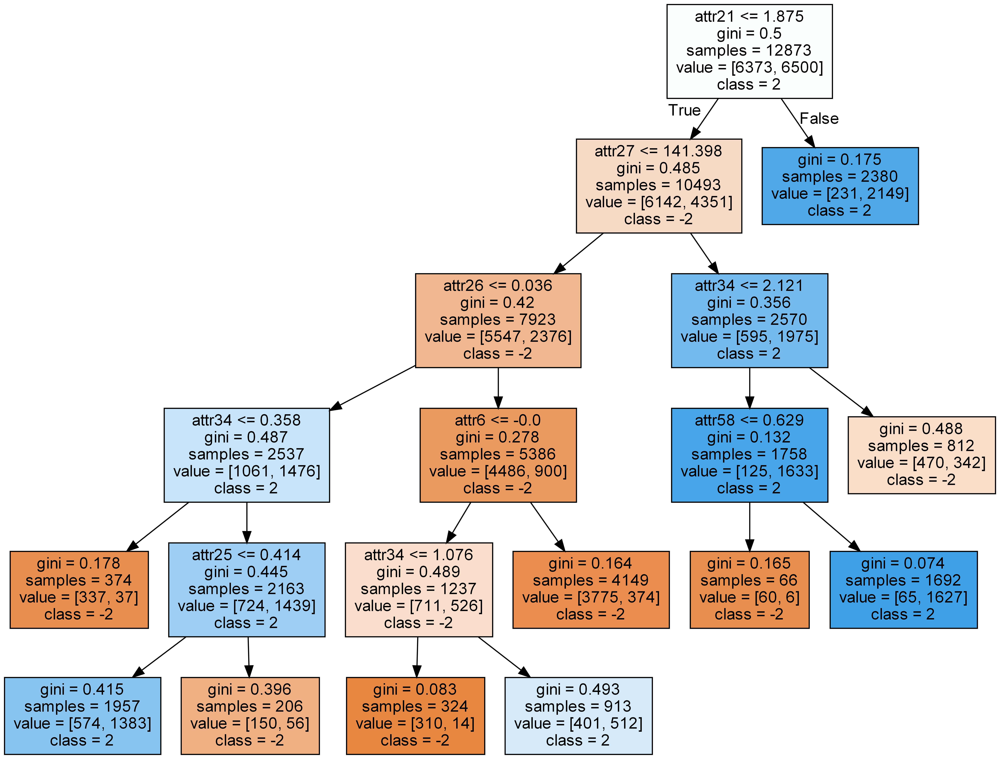

In [38]:
# jupyter notebook에서 .png 직접 출력
from IPython.display import Image
Image(filename = 'MICE_decistion-tree_AF2year.png')

[ max_depth의 제약이 없는 경우의 Decision Tree 시각화 ]


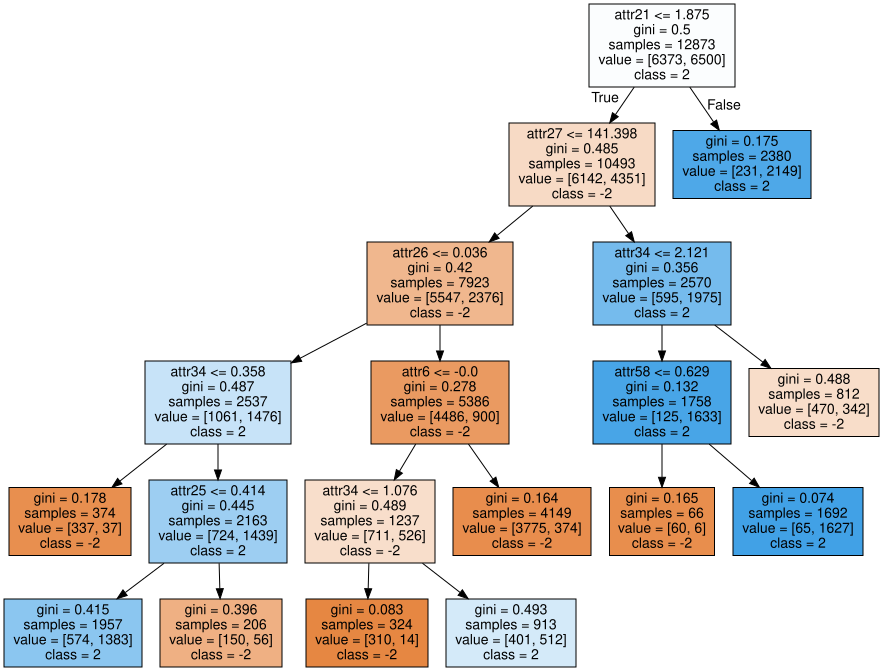

In [39]:
print('[ max_depth의 제약이 없는 경우의 Decision Tree 시각화 ]')
# 위에서 생성된 tree.dot 파일을 Graphiviz 가 읽어서 시각화
with open("tree.dot") as f:
    dot_graph = f.read()
graphviz.Source(dot_graph)

# 1년후 파산(1)과 파산하지 않음(-1)을 분류하는 Decision Tree

In [40]:
dt_clf = DecisionTreeClassifier(random_state=404,min_impurity_decrease=0.005)
dt_clf.fit(Mx_train[4],My_train[4]) # 학습
classe_names = dt_clf.classes_
classe_names= classe_names.astype(str)
My_pred = dt_clf.predict(Mx_test[4])

In [41]:
matrix_show(dt_clf,Mx_test[4],Mx_train[4],My_test[4],My_train[4],My_pred)

Train_Accuracy :  0.8723739495798319 

Test_Accuracy :  0.8498774509803921 

Accuracy:  0.85 

Recall:  0.85 

Precision:  0.85 

F1_score:  0.85 

Confusion Matrix: 
 [[1389  293]
 [ 197 1385]]


In [42]:
# export_graphviz( )의 호출 결과로 out_file로 지정된 tree.dot 파일을 생성
export_graphviz(dt_clf, out_file="tree.dot", class_names =classe_names, feature_names =MXs[1].columns, impurity=True, filled=True)

In [43]:
# 생성된 .dot 파일을 .png로 변환
from subprocess import call
call(['dot', '-Tpng', 'tree.dot', '-o', 'MICE_decistion-tree_AF1year.png', '-Gdpi=600'])

0

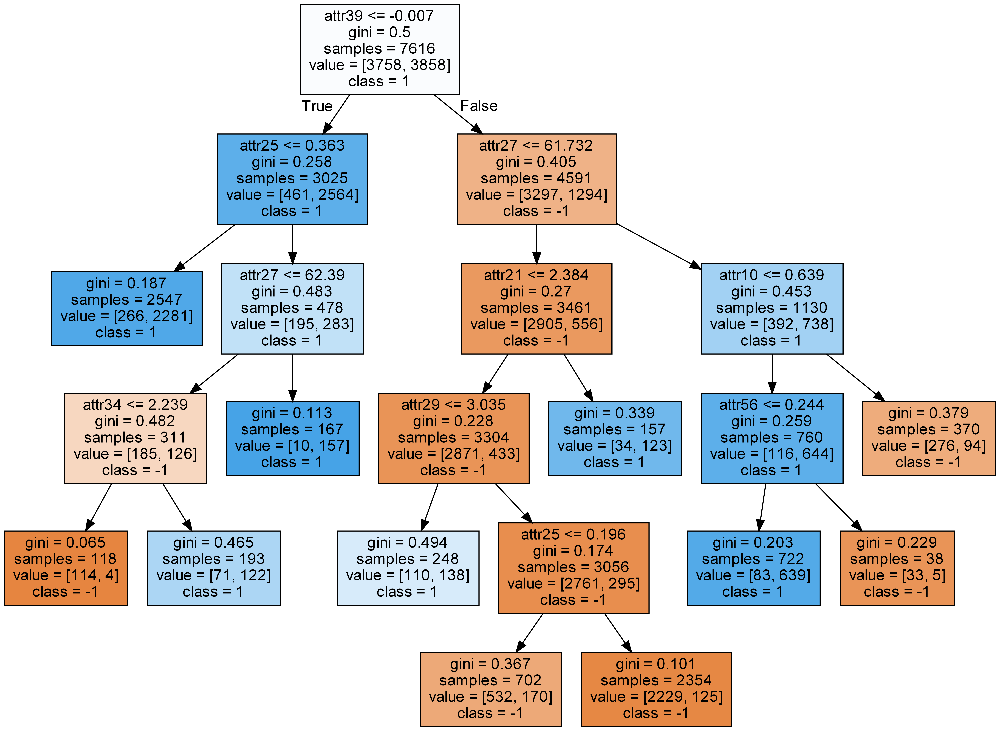

In [44]:
# jupyter notebook에서 .png 직접 출력
from IPython.display import Image
Image(filename = 'MICE_decistion-tree_AF1year.png')

[ max_depth의 제약이 없는 경우의 Decision Tree 시각화 ]


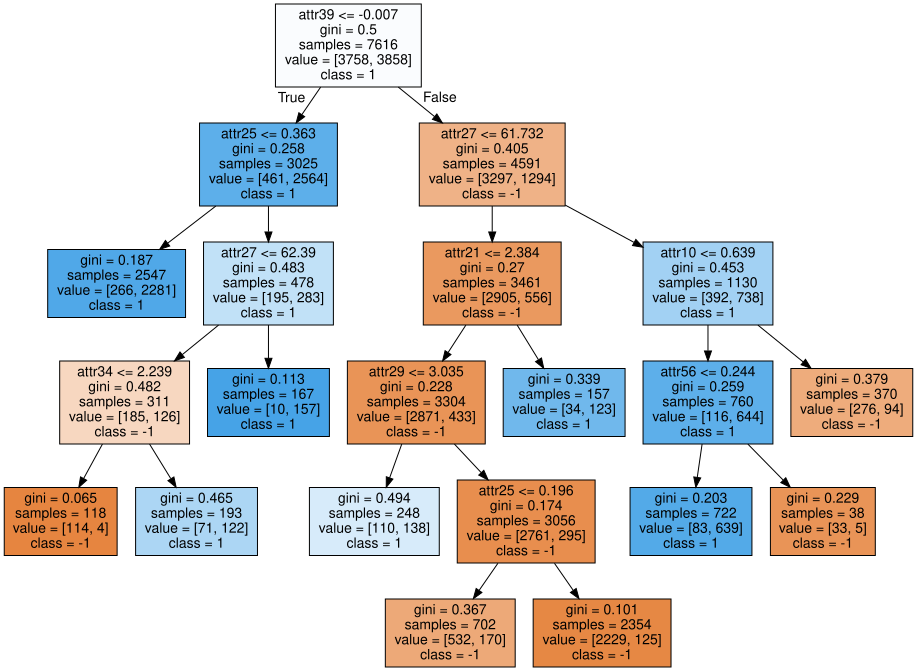

In [45]:
print('[ max_depth의 제약이 없는 경우의 Decision Tree 시각화 ]')
# 위에서 생성된 tree.dot 파일을 Graphiviz 가 읽어서 시각화
with open("tree.dot") as f:
    dot_graph = f.read()
graphviz.Source(dot_graph)

# 6 class 분류하는 모델 (0,1,2,3,4,5)

In [46]:
df =  pd.read_csv("Mdf_6label.csv")

#오버 샘플링
X =df.drop(labels=['bankruptcy'], axis=1)
y = df['bankruptcy']
oversample = SMOTE()
MXs, MYs = oversample.fit_resample(X,y)
MYs = MYs.astype(int)

In [47]:
Mx_train, Mx_test, My_train, My_test = train_test_split(MXs,MYs,test_size=0.3,random_state=seed)

In [48]:
dt_clf = DecisionTreeClassifier(random_state=404,min_impurity_decrease=0.0005)
dt_clf.fit(Mx_train,My_train) # 학습
classe_names = dt_clf.classes_
classe_names= classe_names.astype(str)

In [49]:
My_pred = dt_clf.predict(Mx_test) 

In [50]:
matrix_show(dt_clf,Mx_test,Mx_train,My_test,My_train,My_pred)

Train_Accuracy :  0.5074959552105036 

Test_Accuracy :  0.5001086366105377 

Accuracy:  0.50 

Recall:  0.50 

Precision:  0.50 

F1_score:  0.50 

Confusion Matrix: 
 [[8273 1175  726  610  766  670]
 [ 470 6966 1890  855  933 1140]
 [ 752 2803 4641 1215 1597 1415]
 [ 809 2401 1902 3600 1816 1656]
 [ 699 1539 1633  969 5018 2444]
 [ 351  809  811  456 1500 8330]]


In [51]:
# export_graphviz( )의 호출 결과로 out_file로 지정된 tree.dot 파일을 생성
export_graphviz(dt_clf, out_file="tree.dot", class_names =classe_names, feature_names =MXs.columns, impurity=True, filled=True)

In [52]:
# 생성된 .dot 파일을 .png로 변환
from subprocess import call
call(['dot', '-Tpng', 'tree.dot', '-o', 'MICE_decistion-tree_6class.png', '-Gdpi=600'])

0

In [53]:
# jupyter notebook에서 .png 직접 출력
from IPython.display import Image
Image(filename = 'MICE_decistion-tree_6class.png')

[ max_depth의 제약이 없는 경우의 Decision Tree 시각화 ]


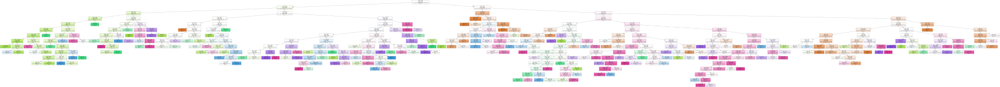

In [54]:
print('[ max_depth의 제약이 없는 경우의 Decision Tree 시각화 ]')
# 위에서 생성된 tree.dot 파일을 Graphiviz 가 읽어서 시각화
with open("tree.dot") as f:
    dot_graph = f.read()
graphviz.Source(dot_graph)

# 3 class 분류하는 모델 (0,1,2,3,4,5)

In [55]:
df =  pd.read_csv("Mdf_3label.csv")

#오버 샘플링
X =df.drop(labels=['bankruptcy'], axis=1)
y = df['bankruptcy']
oversample = SMOTE()
MXs, MYs = oversample.fit_resample(X,y)
MYs = MYs.astype(int)

In [56]:
Mx_train, Mx_test, My_train, My_test = train_test_split(MXs,MYs,test_size=0.3,random_state=seed)

In [57]:
dt_clf = DecisionTreeClassifier(random_state=404,min_impurity_decrease=0.001)
dt_clf.fit(Mx_train,My_train) # 학습
classe_names = dt_clf.classes_
classe_names= classe_names.astype(str)

In [58]:
My_pred = dt_clf.predict(Mx_test) 

In [59]:
matrix_show(dt_clf,Mx_test,Mx_train,My_test,My_train,My_pred)

Train_Accuracy :  0.6391899237806641 

Test_Accuracy :  0.6295236810147079 

Accuracy:  0.63 

Recall:  0.63 

Precision:  0.63 

F1_score:  0.63 

Confusion Matrix: 
 [[9787  773 1882]
 [1707 4838 5798]
 [1551 2017 8702]]


In [60]:
# export_graphviz( )의 호출 결과로 out_file로 지정된 tree.dot 파일을 생성
export_graphviz(dt_clf, out_file="tree.dot", class_names =classe_names, feature_names =MXs.columns, impurity=True, filled=True)

[ max_depth의 제약이 없는 경우의 Decision Tree 시각화 ]


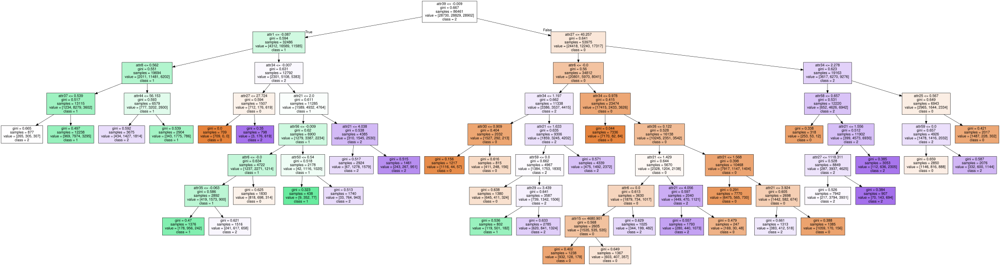

In [61]:
print('[ max_depth의 제약이 없는 경우의 Decision Tree 시각화 ]')
# 위에서 생성된 tree.dot 파일을 Graphiviz 가 읽어서 시각화
with open("tree.dot") as f:
    dot_graph = f.read()
graphviz.Source(dot_graph)

# 파산하지 않음을 제외한 1,2,3,4,5 CLASS 분류

In [71]:
df =  pd.read_csv("Mdf_6label.csv")

idx=df[df['bankruptcy']==0].index
df.drop(idx,inplace=True)

#오버 샘플링
X =df.drop(labels=['bankruptcy'], axis=1)
y = df['bankruptcy'].to_frame()
oversample = SMOTE()
MXs, MYs = oversample.fit_resample(X,y)
MYs = MYs.astype(int)

In [72]:
Mx_train, Mx_test, My_train, My_test = train_test_split(X,y,test_size=0.3,random_state=seed)

Text(0.5, 1.0, 'Class Distributions \n (0: Fin. Stable || 1: Fin. Unstable)')

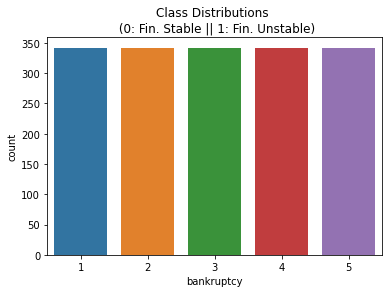

In [73]:
# SMOTE 패키지로 oversampling 진행
from imblearn.over_sampling import SMOTE
smote = SMOTE(random_state=42, k_neighbors=5)
Mx_train, My_train = smote.fit_resample(Mx_train, My_train)

sns.countplot(x=My_train['bankruptcy'])
plt.title('Class Distributions \n (0: Fin. Stable || 1: Fin. Unstable)')

In [74]:
dt_clf = DecisionTreeClassifier(random_state=404,max_depth=12,min_impurity_decrease=0.001)
dt_clf.fit(Mx_train,My_train) # 학습
classe_names = dt_clf.classes_
classe_names= classe_names.astype(str)

In [75]:
My_pred = dt_clf.predict(Mx_test) 
matrix_show(dt_clf,Mx_test,Mx_train,My_test,My_train,My_pred)

Train_Accuracy :  0.7906432748538011 

Test_Accuracy :  0.25081967213114753 

Accuracy:  0.25 

Recall:  0.25 

Precision:  0.25 

F1_score:  0.25 

Confusion Matrix: 
 [[40 36 15 12 19]
 [36 31 39 26 31]
 [27 34 37 21 22]
 [11 21 20 23 36]
 [ 7 17 12 15 22]]


In [76]:
# export_graphviz( )의 호출 결과로 out_file로 지정된 tree.dot 파일을 생성
export_graphviz(dt_clf, out_file="tree.dot", class_names =classe_names, feature_names =X.columns, impurity=True, filled=True)

In [77]:
# 생성된 .dot 파일을 .png로 변환
from subprocess import call
call(['dot', '-Tpng', 'tree.dot', '-o', 'MICE_decistion-tree_12345_Bankruptcy.png', '-Gdpi=600'])

0

In [78]:
# jupyter notebook에서 .png 직접 출력
from IPython.display import Image
Image(filename = 'MICE_decistion-tree_12345_Bankruptcy.png')

[ max_depth의 제약이 없는 경우의 Decision Tree 시각화 ]


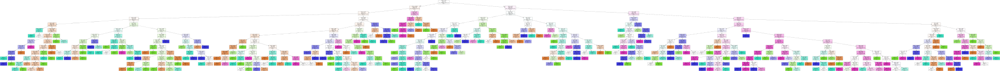

In [79]:
print('[ max_depth의 제약이 없는 경우의 Decision Tree 시각화 ]')
# 위에서 생성된 tree.dot 파일을 Graphiviz 가 읽어서 시각화
with open("tree.dot") as f:
    dot_graph = f.read()
graphviz.Source(dot_graph)